# Looking at the Effect of Dams in the Meander Signal

This code provides an example of meander characterization using the tools `WigglyRivers` provide and extracting the information from the NHDPlus High-Resolution dataset. Please look at the `Extractr_NHDPlus_HR_Data.ipynb` to know how to download and preprocess the NHDPlus HR information. 

In this workflow, we will use the HUC 0601 NHDPlus High-Resolution that is saved in the `NHDPlus_HR/raw_data/` folder, and the resulting files will be saved in the `./NHDPlus_HR/processed_data/NHDPlus_H_0602_HU4_GDB/` folder. 

## Extracting NHD Information
### Importing Packages

In [5]:
%load_ext autoreload
%autoreload 2
%matplotlib ipympl

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [18]:
# Importing Packages
import os
import time
import copy
import numpy as np
import pyproj
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from IPython.display import Image, display, HTML
from joblib import Parallel, delayed
import plotly.io as pio
import ipywidgets as widgets
from IPython.display import display
from scipy.spatial import Delaunay
from scipy.spatial.distance import euclidean

# Importing pyMeander Packages
from WigglyRivers import RiverDatasets
from WigglyRivers import RiverFunctions as RF
from WigglyRivers import ExtractNHDPlusHRData as NHD
from WigglyRivers.utilities import utilities as utl
from WigglyRivers.utilities import filesManagement as FM
from WigglyRivers import Logger
from WigglyRivers import WaveletTreeFunctions as WTFunc
from WigglyRivers import graphs

In [7]:
# Start Logger
logger = Logger(console=True)

2023-11-27 14:16:11,999[INFO] set_logger: Starting log
2023-11-27 14:16:11,999[INFO] set_logger: Starting log


In [8]:
# Parameters
# huc_id = '0602'
# huc_id = '0104'
huc_id = '0601'
path_nhd = f'./NHDPlus_HR/raw_data/NHDPlus_H_{huc_id}_HU4_GDB/'
path_output = f'./NHDPlus_HR/processed_data/NHDPlus_H_{huc_id}_HU4_GDB/'
path_river_routing = f'{path_output}/river_routing/'
path_meander_info = f'{path_output}/meanders/'
file_name = f'NHDPlus_H_{huc_id}_HU4_GDB.gdb'
projection = 'esri:102003'

### Extract NHDPlus HR Data

To do the preprocessing of information we use the following function

In [5]:
# Create Logger
# Create NHD object
time_1 = time.time()
nhd = NHD(path_output=path_output, logger=logger, save_format='feather')
nhd.get_data_from_nhd_gbd(f'{path_nhd}{file_name}', projection=projection)
utl.toc(time_1)

2023-11-06 11:10:40,233[INFO] info: Start Logger in ExtractNHDPlusHRData
2023-11-06 11:10:40,235[INFO] info: Start: Extracting data from './NHDPlus_HR/raw_data/NHDPlus_H_0601_HU4_GDB/NHDPlus_H_0601_HU4_GDB.gdb'
2023-11-06 11:10:40,235[INFO] info:  Start: Load Shapefile
2023-11-06 11:12:02,134[INFO] info:  Done: Load Shapefile
2023-11-06 11:12:02,135[INFO] info:  Setting shapefile projection to esri:102003
2023-11-06 11:12:04,376[INFO] info:  Start: Extraction of coordinates
2023-11-06 11:12:44,242[INFO] info:  Done: Extraction of coordinates
2023-11-06 11:13:06,845[INFO] info:  Start: Merging Tables
2023-11-06 11:13:06,846[INFO] info:   Merging NHDPlusFlowlineVAA
2023-11-06 11:15:10,492[INFO] info:   Merging NHDPlusEROMMA
2023-11-06 11:16:23,059[INFO] info:  Done: Merging Tables
2023-11-06 11:16:23,251[INFO] info:  Saving ./NHDPlus_HR/processed_data/NHDPlus_H_0601_HU4_GDB//tables//file_tables_raw.feather
2023-11-06 11:16:23,893[WARNING] warning:   WARNING: The coordinates are always sa

====	7.0904 minutes	 ====


### Extracting Individual Reach Data

The NHD network is composed of reach information that is separated by COMID values, in this case the COMID is called `NHDPlusID`. The function above separated the coordinates and the table with all the data related to each reach.

As our objective is to capture meanders we need complete reach information, that is, we need to extract coordinates from rivers that can spam the union of several reach values. To do that we will use the methods within the `Rivers` class that uses the preprocessed data extracted above.

To do that we need to follow the steps below:

1. **Start River Object**: This process is performed within the `Rivers` class. 


In [13]:
# Directories of the information
path_tables = f'{path_output}/tables/'
path_coords = f'{path_output}/coordinates/'

# Create Rivers object
rivers = RiverDatasets(logger=logger)
# Add  files
rivers.add_files(path_data=path_tables, huc04=huc_id, path_coords=path_coords,
                comid_id='nhdplusid')

2023-11-14 14:33:40,284[INFO] info: Start Logger in Rivers
2023-11-14 14:33:42,643[INFO] info: Starting logger CompleteReachExtraction


2. **Get Individual Reach**: For this example we will be extracting only one complete reach from the network using the `Rivers.get_reach(id_value, start_comid=<selected_value>)` method. This method will map the reach through the network until it goes out of the selected system, such as region (HUC 2), subregion (HUC 4), basin (HUC 6), subbasin (HUC 8), watershed (HUC 10) or subwatershed (HUC 12). Each system can be selected with the parameter `huc` within the method, by default this value is 8 (subbasin).

    For this example we will be using the `start_comid=25000400007384` as the mapping of this reach passes through a number of dams.

In [14]:
# Get Reach
comid_st = float(25000400007384)  # 6 dams
comid_st = float(25000400137983)  # 3 dams
comid_st_values = [25000400007384, 25000400137983]
kwargs_resample = {'smooth': 1e2}
for comid_st in comid_st_values:
    rivers.get_reach(comid_st, start_comid=comid_st, huc=4, kwargs_resample=kwargs_resample)
rivers.save_rivers(path_river_routing, file_name=f'river_dam_exploration.hdf5')

2023-11-14 14:33:43,552[INFO] info: Getting COMID network
2023-11-14 14:33:44,024[INFO] info: Mapping coordinates
2023-11-14 14:34:06,209[INFO] info: Adding River
2023-11-14 14:34:06,432[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-14 14:34:06,437[INFO] info: Getting COMID network
2023-11-14 14:34:06,720[INFO] info: Mapping coordinates
2023-11-14 14:34:27,187[INFO] info: Adding River
2023-11-14 14:34:27,248[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-14 14:34:27,250[INFO] info: Saving 25000400007384
2023-11-14 14:34:27,251[INFO] info: 25000400007384 No CWT poly or ZC lines extracted
2023-11-14 14:34:27,251[INFO] info: 25000400007384 No tree scales extracted
2023-11-14 14:34:27,252[INFO] info: 25000400007384 No meanders extracted to save
2023-11-14 14:34:27,252[INFO] info: Saving 25000400137983
2023-11-14 14:34:27,253[INFO] info: 25000400137983 No CWT poly or ZC lines extracted
2023-11-14 14:34:27,253[INFO] info: 25000400137983 No t

In [8]:
# Plot with plotly
fig = rivers.plot_rivers(engine='plotly')
fig.show()

In [94]:
rivers_or = copy.deepcopy(rivers)

## Explore Network

With the `river_25000400007384.0.hdf5` file we can start exploring the network. We start by loading the file and plotting the network.

In [9]:
# Directories of the information
path_tables = f'{path_output}/tables/'
path_coords = f'{path_output}/coordinates/'

# Create Rivers object
rivers = RiverDatasets(logger=logger)

# Load network into River
river_network_file = f'{path_river_routing}/river_dam_exploration.hdf5'
rivers.load_river_network(river_network_file)
starting_comids = rivers.id_values

2023-11-27 14:16:41,480[INFO] info: Start Logger in RiverDatasets
2023-11-27 14:16:41,480[INFO] info: Start Logger in RiverDatasets
2023-11-27 14:16:41,796[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-27 14:16:41,796[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-27 14:16:41,867[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-27 14:16:41,867[INFO] info: Resample calculated with `River.calculate_spline()`


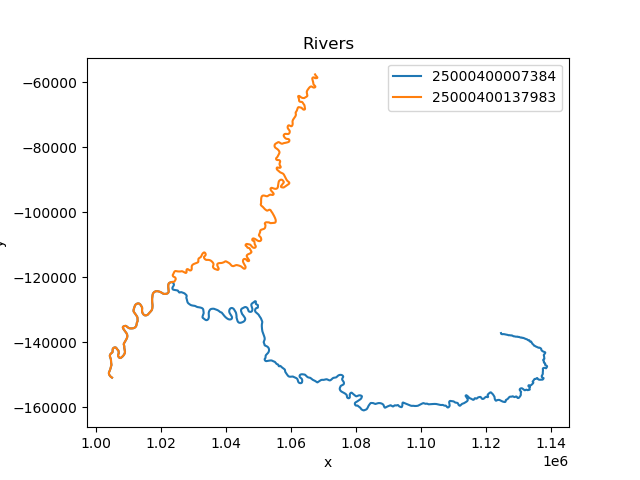

In [10]:
# Plot with matplotlib
fig = rivers.plot_rivers(engine='matplotlib')

The user can also create an interactive plot using the `plotly` engine.

In [12]:
# Plot with plotly
fig = rivers.plot_rivers(engine='plotly', data_source='resample')
fig.show()

TypeError: super(type, obj): obj must be an instance or subtype of type

An important part of plotting been able to plot with plotly is that we can use [MAPBOX](https://www.mapbox.com/), this is an app that allows the plotting with satellite images on the background. To use MAPBOX you would need to first create an account and get a token. Then you can pass `mapbox_token` as an additional parameter of the `plot_rivers` method.

Keep in mind that MAPBOX uses `EPSG:4326` to plot the information, usually the coordinates passed into rivers should be in projected coordiantes because we perform distance operations on them. Thus, you should also give the `current_crs` as another parameter and the method will project the coordiantes to `EPSG:4326` before plotting.

In this example I created a file called `.env` in the same folder as this notebook and added the following line: `MAPBOX_TOKEN=your_token_here`. Then I used the `load_dotenv` method from the `dotenv` package to load the token into the environment variables. Finally, I used the `os` package to get the token from the environment variables.

In [12]:
# Load .env file
import dotenv
satellite_figure = True
dotenv.load_dotenv()
MAPBOX_TOKEN = os.environ['MAPBOX_TOKEN']
# Plot with plotly
fig = rivers.plot_rivers(engine='plotly', mapbox_token=MAPBOX_TOKEN,
                         current_crs='esri:102003', zoom=8)
fig.show()


In [104]:
# Check if waterbody is within the river
np.sum(rivers.rivers[comid_st].within_waterbody)

192034.0

## Meander Characterization App

Now that we have the informaiton form each reach we characterize meanders on the river networks. To do that we use the `river.interactive_meander_characterization_plot()`. 

Keep in mind that if you want to select a meanders that are on each side of the river you would need to hide the already selected meanders clicking on them on the legend.

In [19]:
# Start Rivers object
rivers = Rivers(logger=logger)

# kwargs resample
kwargs_resample = {
    comid_st:{'smooth': 1e2},
}
river_network_file = f'{path_river_routing}/river_dam_exploration.hdf5'
rivers.load_river_network(river_network_file, kwargs_resample=kwargs_resample)
id_rivers = rivers.id_values

# Select River
id_river = id_rivers[1]
river = rivers[id_river]


2023-11-14 14:43:57,167[INFO] info: Start Logger in Rivers
2023-11-14 14:43:57,314[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-14 14:43:57,327[INFO] info: Resample calculated with `River.calculate_spline()`


In [20]:
# Do interactive plot
rivers[id_river].interactive_meander_characterization_plot()

FigureWidget({
    'data': [{'line': {'color': 'blue', 'width': 2},
              'mode': 'lines',
              'name': 'River',
              'type': 'scatter',
              'uid': 'acfee6ce-bb7e-4ec2-9b94-506cafca66a9',
              'x': array([1067534.29528186, 1067529.56089655, 1067529.68675187, ...,
                          1005016.4111849 , 1005043.68206913, 1005064.82079177]),
              'y': array([ -57652.08304294,  -57682.33708573,  -57712.25958714, ...,
                          -150915.04558202, -150920.93503026, -150939.20012329])}],
    'layout': {'autosize': True,
               'height': 500,
               'hovermode': 'closest',
               'margin': {'b': 0, 'l': 0, 'r': 0, 't': 0},
               'plot_bgcolor': 'white',
               'showlegend': True,
               'template': '...',
               'width': 800,
               'xaxis': {'linecolor': 'black',
                         'mirror': True,
                         'showgrid': False,
         

Similar to the plot presented above, we can also select meanders with a satellite image on the back. However, there is known issue with `plotly<=5.15` where plotting mapbox with the interactive widget will prompt the following error message:

```python
ValueError:
Invalid property path 'mapbox._derived' for layout
```

There is a temporary fix to this issue given in the following [GitHub issue webpage](https://github.com/plotly/plotly.py/issues/2570) that requires to run the code block below and restart the kernel.

In [21]:
# To fix the widget error on plotly with mapbox uncomment the following line
# utl.fix_widget_error()

After solving this issue we can use the `interactive_meander_characterization_plot` method by giving the `mapbox_token` and `current_crs` parameters. The plot will work exactly the same as the interactive plot above where you can select the starting and ending points of a meander and the interactive plot will create a new meander show it in red in the plot.

In [28]:
# Do interactive plot
import dotenv
satellite_figure = True
dotenv.load_dotenv()
MAPBOX_TOKEN = os.environ['MAPBOX_TOKEN']
rivers[id_river].interactive_meander_characterization_plot(
    mapbox_token=MAPBOX_TOKEN, current_crs='esri:102003', zoom=7)


FigureWidget({
    'data': [{'lat': array([35.61023302, 35.61022336, 35.61021355, ..., 35.62228238, 35.62227066,
                            35.62225833]),
              'line': {'color': 'blue', 'width': 2},
              'lon': array([-83.43875012, -83.43874442, -83.43873938, ..., -84.77973796,
                            -84.77973678, -84.77973669]),
              'mode': 'lines',
              'name': 'River',
              'type': 'scattermapbox',
              'uid': '327e197f-e80e-4a29-b10d-04dfb28bcfa6'}],
    'layout': {'autosize': True,
               'height': 500,
               'hovermode': 'closest',
               'mapbox': {'accesstoken': ('pk.eyJ1IjoiZGdkMDQyIiwiYSI6ImN' ... '2ZzcifQ.Y0LQAws3OWtzte09c-zv0g'),
                          'bearing': 0,
                          'center': {'lat': 35.61460345233588, 'lon': -84.0764382230596},
                          'pitch': 0,
                          'style': 'satellite',
                          'zoom': 7},
          

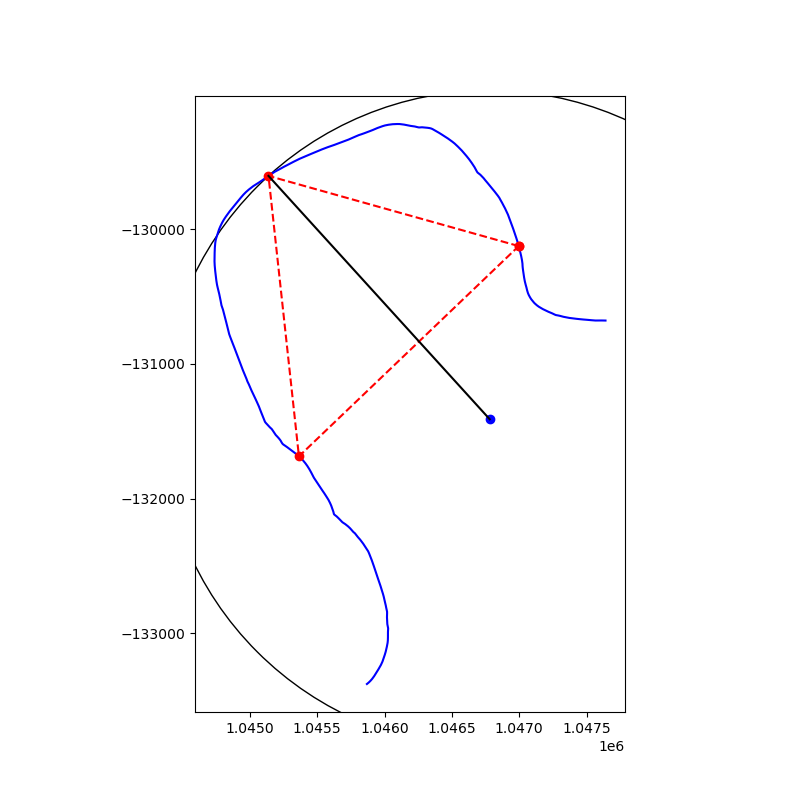

In [114]:
id_meander = 2
f = river.meanders[id_meander].plot_meander()


The selected meanders are saved as `Meander` objects inside a dictionary within the `River` class. The general information of the meanders is also saved in the `database` attribute as a dataframe.

In [115]:
# Display current database
database = river.database
database

,id_reach,huc04_n,huc_n,start_comid,comid,scale,x_start_river,y_start_river,translate,id_meander,...,so,skewness,flatness,radius,s_inf,curvature_side,a_h,lambda_h,lambda_u,lambda_d
id,,,,,,,,,,,,,,,,,,,,,
019fed23-7f3c-11ee-85c0-ec2e98e4452c_0,019fed23-7f3c-11ee-85c0-ec2e98e4452c,25000400007384.0,4,2.500040e+13,2.500040e+13,1,1.124700e+06,-137250.929342,False,0,...,9.0,NaN,NaN,3387.617271,"[200976.2326068516, 206829.95789323706]",1.0,-0.622686,9808.378594,1850.417253,7957.961341
019fed23-7f3c-11ee-85c0-ec2e98e4452c_1,019fed23-7f3c-11ee-85c0-ec2e98e4452c,25000400007384.0,4,2.500040e+13,2.500040e+13,1,1.124700e+06,-137250.929342,False,1,...,9.0,NaN,NaN,3458.515021,"[195076.21556722675, 201022.5769119464]",-1.0,0.406420,11377.385625,8000.689862,3376.695763
019fed23-7f3c-11ee-85c0-ec2e98e4452c_2,019fed23-7f3c-11ee-85c0-ec2e98e4452c,25000400007384.0,4,2.500040e+13,2.500040e+13,1,1.124700e+06,-137250.929342,False,2,...,9.0,NaN,NaN,2441.431410,"[190120.50627468142, 194941.2088770772]",1.0,0.682188,7758.974389,6526.027138,1232.947250


#### Remove a meander

To remove a meander we can use `remove_meander(meander_id)` method in the `River` class. This method will remove the meander with the given `meander_id` from the river. You would also need to rerun the `interactive_meander_characterization_plot` method to update the meanders displayed.

In [16]:
# Remove meander
river.remove_meander(1)

#### Save information

To save the information you can use the method `save_meander_database`. This method will allow you to save the information as tables or as shapefile. Keep in mind that the meanders can be in both directions, thus saving the meander as shapefile will save two files, one file per direction.



In [33]:
# Save meander information in CSV format
river.save_meanders_database(
    path_output=path_meander_info, file_name='meander_database.csv',
    database='meander', type_info='csv')

river.save_meanders_database(
    path_output=path_meander_info, file_name='meander_database.feather',
    database='meander', type_info='feather')

# Save meander information in shapefile format
river.save_meanders_database(
    path_output=f'{path_meander_info}/shapefiles/', file_name='meander_database.shp',
    database='meander', type_info='shapefile', geometry_columns=['x_o', 'y_o'],
    crs='esri:102003')

                             

c:\users\danie\documents\myrepos\pymeanders\pyMeander\utilities\filesManagement.py:126: UserWarning:

Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.

c:\users\danie\documents\myrepos\pymeanders\pyMeander\utilities\filesManagement.py:126: UserWarning:

Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.



#### Save and Load rivers

You can save the your entire work in files that could be later loaded by `Rivers` using the `Rivers.save_rivers` method. If you use the `.hdf5` extension on the file you will save all the rivers as `hdf5` files and the meander database as `csv`

In [44]:
# Save rivers
path_project = f'{path_output}/meander_manual_selection/'
rivers.save_rivers(
    path_project, file_name='rivers.hdf5',
    fn_meander_database='meander_database.csv')


2023-08-23 18:37:01,454[INFO] info: No CWT poly or ZC lines extracted
2023-08-23 18:37:01,454[INFO] info: No tree scales extracted
2023-08-23 18:37:01,455[INFO] info: No meanders extracted to save
2023-08-23 18:37:01,456[INFO] info: No CWT poly or ZC lines extracted
2023-08-23 18:37:01,456[INFO] info: No tree scales extracted
2023-08-23 18:37:01,457[INFO] info: No meanders extracted to save
2023-08-23 18:37:01,459[INFO] info: No CWT poly or ZC lines extracted
2023-08-23 18:37:01,460[INFO] info: No tree scales extracted
2023-08-23 18:37:01,460[INFO] info: No CWT poly or ZC lines extracted
2023-08-23 18:37:01,461[INFO] info: No tree scales extracted
2023-08-23 18:37:01,461[INFO] info: No meanders extracted to save
2023-08-23 18:37:01,462[INFO] info: No CWT poly or ZC lines extracted
2023-08-23 18:37:01,462[INFO] info: No tree scales extracted
2023-08-23 18:37:01,463[INFO] info: No meanders extracted to save


In [47]:
# Start Rivers object
# path_project = f'{path_output}/meander_manual_selection/'
rivers = Rivers(logger=logger)
# river_network_file = f'{path_project}/rivers.hdf5'
river_network_file = f'{path_river_routing}/river_dam_exploration.hdf5'
rivers.load_river_network(
    river_network_file,
    # fn_meanders_database=f'{path_project}/meander_database.csv'
    )
id_rivers = rivers.id_values

# Select River
id_river = id_rivers[2]
river = rivers[id_river]

# kwargs resample
kwargs_resample = {
    id_river:{'smooth': len(river.x)*1e2},
}

# Re-load river
rivers.load_river_network(river_network_file, kwargs_resample=kwargs_resample)
id_rivers = rivers.id_values

# Select River
id_river = id_rivers[2]
river = rivers[id_river]

2023-08-23 18:37:28,063[INFO] info: Start Logger in Rivers
2023-08-23 18:37:28,102[WARNING] warning: Spline not calculated, calculating splines with `calculate_spline()`
2023-08-23 18:37:28,106[WARNING] warning: Spline not calculated, calculating splines with `calculate_spline()`
2023-08-23 18:37:28,114[WARNING] warning: Spline not calculated, calculating splines with `calculate_spline()`
2023-08-23 18:37:28,167[WARNING] warning: Spline not calculated, calculating splines with `calculate_spline()`
2023-08-23 18:37:28,172[WARNING] warning: Spline not calculated, calculating splines with `calculate_spline()`


In [55]:
rivers[id_river].interactive_meander_characterization_plot()


FigureWidget({
    'data': [{'line': {'color': 'blue', 'width': 2},
              'mode': 'lines',
              'name': 'River',
              'type': 'scatter',
              'uid': '7e8dbf17-80f6-4952-bfb9-1884d710eeaa',
              'x': array([1934059.26224843, 1934104.17131248, 1934150.2829003 , ...,
                          2063968.01570591, 2064008.4960604 , 2064048.97839471]),
              'y': array([1116154.89691333, 1116141.62222088, 1116136.133648  , ...,
                          1011173.22794466, 1011196.11499387, 1011219.00134204])},
             {'hovertemplate': ('<b>Meander ID: 0</b><br>Lambda' ... 'nuosity: 1.63<br>Radius: 74.90'),
              'marker': {'color': 'red', 'size': 10},
              'mode': 'markers',
              'name': 'Meander 0',
              'showlegend': False,
              'type': 'scatter',
              'uid': '4902c791-58f2-4151-864d-447c95db7391',
              'x': [1945906.569615304],
              'y': [1083673.7749246547]},
    

# River Characterization

We can do a preliminary analysis on the river geomorphological characteristics by looking at it's spectrum behavior.

In [25]:
# Load Rivers with the data
comid_st = str(25000400007384)
# river_network_file = f'{path_river_routing}/river_{comid_st}.hdf5'
river_network_file = f'{path_river_routing}/river_dam_exploration.hdf5'
rivers = RiverDatasets(logger=logger)
# kwargs_resample = {
#     comid_st:{'smooth': 1e2},
# }
# rivers.load_river_network(river_network_file, kwargs_resample=kwargs_resample)
rivers.load_river_network(river_network_file)
id_rivers = rivers.id_values[1]
comid_st = id_rivers
# -----------------------------
# Calculate Curvature
# -----------------------------
rivers[comid_st].calculate_curvature(data_source='resample') 

2023-11-27 14:45:14,554[INFO] info: Start Logger in RiverDatasets
2023-11-27 14:45:14,554[INFO] info: Start Logger in RiverDatasets
2023-11-27 14:45:14,866[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-27 14:45:14,866[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-27 14:45:14,932[INFO] info: Resample calculated with `River.calculate_spline()`
2023-11-27 14:45:14,932[INFO] info: Resample calculated with `River.calculate_spline()`


In [26]:
# Load DAMS data
dams_shapefile_file = f'DAM_info/Selected_DAMS/Selected_DAMS.shp'
# dams_shapefile_file = f'DAM_info/Selected_DAMS/Selected_DAMS_2.shp'
dams_shapefile = gpd.read_file(dams_shapefile_file)

x_dams = dams_shapefile.geometry.x.values
y_dams = dams_shapefile.geometry.y.values

# Get the closest point
x = rivers[comid_st].x
y = rivers[comid_st].y

# Get the closest point
from sklearn.metrics.pairwise import pairwise_distances_argmin_min
idx_dams = pairwise_distances_argmin_min(
    X=np.array([x_dams, y_dams]).T, Y=np.array([x, y]).T)[0]
print('Done')


Done


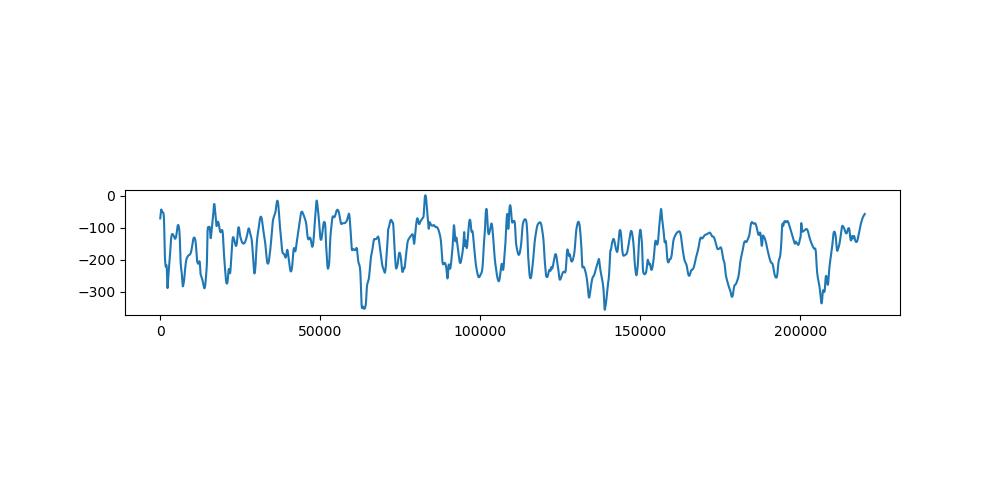

In [27]:
# Plot Angle
s = rivers[comid_st].s
angle = rivers[comid_st].angle
plt.figure(figsize=(10, 5))
plt.plot(s, angle*180/np.pi)
plt.gca().set_aspect(100, adjustable='box')
plt.show()

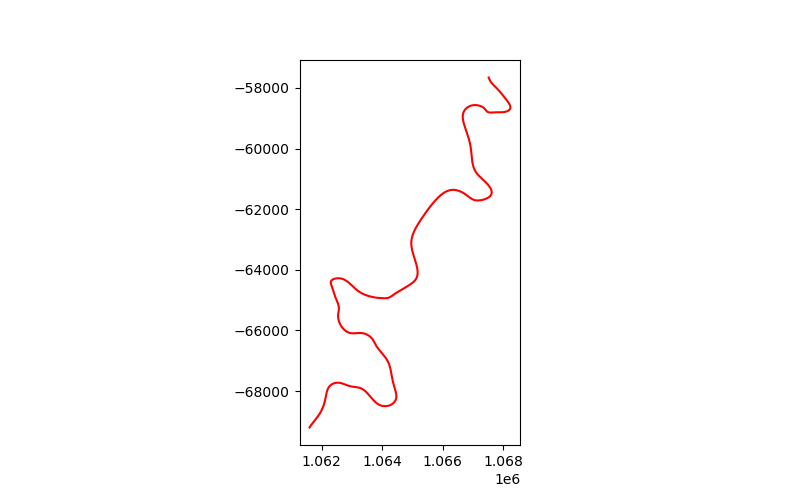

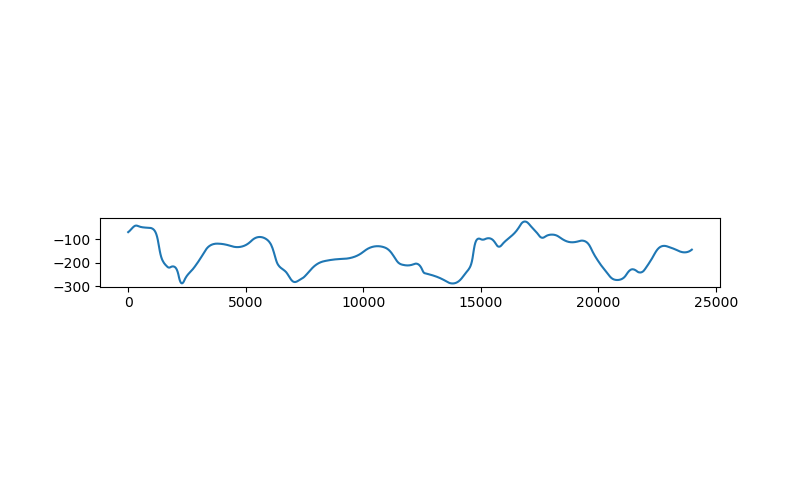

In [28]:
s = rivers[comid_st].s
angle = rivers[comid_st].angle
c = rivers[comid_st].c
x = rivers[comid_st].x
y = rivers[comid_st].y

# clip_1 = 24000
clip = 24000
s_clip = s[s < clip]
angle_clip = angle[s < clip]
x_clip = x[s < clip]
y_clip = y[s < clip]

plt.close('all')
plt.figure(figsize=(8, 5))
# plt.plot(x, y, 'k')
# plt.plot(x[idx_dams], y[idx_dams], 'ro')
plt.plot(x_clip, y_clip, 'r')
plt.gca().set_aspect('equal', adjustable='box')
plt.show()

plt.figure(figsize=(8, 5))
plt.plot(s_clip, angle_clip*180/np.pi)
plt.gca().set_aspect(10, adjustable='box')
plt.show()



In [30]:
# Include angle CWT
rivers[comid_st].get_cwt_curvature(mother='MORLET')
rivers[comid_st].get_cwt_angle(mother='MORLET')

In [10]:
def plot_complete_values(river, idx_dams=None):

    # Extract Information
    x = river.x
    y = river.y
    s = river.s
    angle = river.angle
    c = river.c
    wavelen_c = river.cwt_wavelength_c
    wavelen_angle = river.cwt_wavelength_angle
    power_c = river.cwt_power_c
    coi_c = river.cwt_coi_c
    power_angle = river.cwt_power_angle
    coi_angle = river.cwt_coi_angle
    gws_c = river.cwt_gws_c
    gws_angle = river.cwt_gws_angle
    sawp_c = river.cwt_sawp_c
    sawp_angle = river.cwt_sawp_angle
    gws_peak_wavelen_c = river.cwt_gws_peak_wavelength_c
    gws_peak_wavelen_angle = river.cwt_gws_peak_wavelength_angle

    plt.close('all')

    fig, ax = plt.subplots(7, 1, figsize=(8, 10))
    ax = ax.ravel()
    # Planimetry Coordinate
    i_d = 0
    ax[i_d].plot(x, y, 'k', linewidth=1.5)
    if idx_dams is not None:
        ax[i_d].plot(x[idx_dams], y[idx_dams], 'ro')
    ax[i_d].set_aspect('equal')
    # Extend y axis
    ax[i_d].set_ylim([np.min(y)-np.std(y), np.max(y)+np.std(y)])
    ax[i_d].set_xticks([])
    ax[i_d].set_yticks([])
    # Remove axis lines
    ax[i_d].spines['top'].set_visible(False)
    ax[i_d].spines['right'].set_visible(False)
    ax[i_d].spines['bottom'].set_visible(False)
    ax[i_d].spines['left'].set_visible(False)
    ax[i_d].set_title('River Planimetry')


    # Curvature
    i_d = 1
    ax[i_d].plot(s, c, 'k', linewidth=0.5)
    if idx_dams is not None:
        for idx in idx_dams:
            ax[i_d].axvline(s[idx], color='r', linestyle='--')
    ax[i_d].set_xlim([np.min(s), np.max(s)])
    # ax[i_d].set_xticklabels([])
    ax[i_d].set_ylabel(r'$c$')
    ax[i_d].set_title('Curvature')

    # Power Curvature
    i_d = 2
    im_c = ax[i_d].pcolormesh(s, wavelen_c, power_c, shading='auto', cmap='Blues')
    if idx_dams is not None:
        for idx in idx_dams:
            ax[i_d].axvline(s[idx], color='r', linestyle='--')
    # Plot COI
    ax[i_d].fill_between(s, coi_c*0+wavelen_c[-1], coi_c, facecolor='none',
                        edgecolor='#00000040', hatch='x')
    ax[i_d].set_yscale('log')
    ax[i_d].set_ylim([np.max(wavelen_c), np.min(wavelen_c)])
    ax[i_d].set_xlim([np.min(s), np.max(s)])
    # for peak in gws_peak_wavelen_c:
    #     ax[i_d].axhline(peak, color='r', linestyle='--')
    # ax[i_d].set_xticklabels([])
    # Move Figure

    # SAWP
    i_d = 3
    ax[i_d].plot(s, sawp_c, 'k', linewidth=0.5)
    ax[i_d].set_xlim([np.min(s), np.max(s)])
    ax[i_d].set_xlabel('Distance (m)')
    ax[i_d].set_ylabel('SAWP')

    # Angle
    i_d = 4
    ax[i_d].plot(s, angle, 'k', linewidth=0.5)
    if idx_dams is not None:
        for idx in idx_dams:
            ax[i_d].axvline(s[idx], color='r', linestyle='--')
    ax[i_d].set_xlim([np.min(s), np.max(s)])
    ax[i_d].set_ylabel(f'$\\theta$')
    ax[i_d].set_title('Direction Angle')

    # Power Curvature
    i_d = 5
    im_angle = ax[i_d].pcolormesh(s, wavelen_angle, power_angle, shading='auto', cmap='Blues')
    if idx_dams is not None:
        for idx in idx_dams:
            ax[i_d].axvline(s[idx], color='r', linestyle='--')
    ax[i_d].fill_between(s, coi_angle*0+wavelen_angle[-1], coi_angle, facecolor='none',
                        edgecolor='#00000040', hatch='x')
    ax[i_d].set_yscale('log')
    ax[i_d].set_ylim([np.max(wavelen_angle), np.min(wavelen_angle)])
    ax[i_d].set_xlim([np.min(s), np.max(s)])
    # for peak in gws_peak_wavelen_angle:
    #     ax[i_d].axhline(peak, color='r', linestyle='--')
    # SAWP
    i_d = 6
    ax[i_d].plot(s, sawp_angle, 'k', linewidth=0.5)
    ax[i_d].set_xlim([np.min(s), np.max(s)])
    ax[i_d].set_ylabel('SAWP')
    ax[i_d].set_xlabel('Distance (m)')

    plt.tight_layout()
    fig.subplots_adjust(left=0.25, right=0.90)
    # Add GWS c
    pos = ax[2].get_position()
    ax_gws_c = fig.add_axes([0.1, pos.y0, 0.135, pos.height])
    ax_gws_c.plot(gws_c, wavelen_c, 'k', linewidth=0.5)
    ax_gws_c.set_yscale('log')
    ax_gws_c.set_ylim([np.max(wavelen_c), np.min(wavelen_c)])
    ax_gws_c.set_ylabel(f'$\lambda$ (m)')
    ax_gws_c.set_xlabel('Power (m$^2$)')
    ax_gws_c.set_title('GWS')
    # for peak in gws_peak_wavelen_c:
    #     ax_gws_c.axhline(peak, color='r', linestyle='--')

    pos = ax[5].get_position()
    ax_gws_angle = fig.add_axes([0.1, pos.y0, 0.135, pos.height])
    ax_gws_angle.plot(gws_angle, wavelen_angle, 'k', linewidth=0.5)
    ax_gws_angle.set_yscale('log')
    ax_gws_angle.set_ylim([np.max(wavelen_angle), np.min(wavelen_angle)])
    ax_gws_angle.set_ylabel(f'$\lambda$ (m)')
    ax_gws_angle.set_xlabel('Power (m$^2$)')
    ax_gws_angle.set_title('GWS')
    # for peak in gws_peak_wavelen_angle:
    #     ax_gws_angle.axhline(peak, color='r', linestyle='--')
    return

In [23]:
river = rivers[comid_st]
# graphs.plot
graphs.plot_river_spectrum_compiled(
    river, only_significant=True, idx_data=idx_dams)
# plot_complete_values(river, idx_dams)
plt.savefig(f'{path_output}/figures/curvature_{comid_st}.png', dpi=300, bbox_inches='tight')
plt.close('all')



## Automatic Detection of Meanders and River Characterization

We can performed automatic detection on the same reaches. All of the automatically detected rivers will be saved in the database with the `automaic_flag` as 1. To perform the automatic detection please follow the steps below:

In [6]:
# Load Rivers with the data
comid_st = float(25000400007384)
river_network_file = f'{path_river_routing}/river_{comid_st}.hdf5'
rivers = Rivers(logger=logger)
kwargs_resample = {
    comid_st:{'smooth': 1e2},
}
rivers.load_river_network(river_network_file, kwargs_resample=kwargs_resample)
id_rivers = rivers.id_values


2023-11-12 11:09:54,768[INFO] info: Start Logger in Rivers
2023-11-12 11:09:54,952[INFO] info: Resample calculated with `River.calculate_spline()`


### Process to perform automatic detection

The process to perform the automatic detection from a created rivers object involves the following steps:

1. **Smooth River planimetry**: Use the function `rivers[id_river].calculate_smooth()` to smooth the river planimetry, this will make the calculation .

In [7]:
# Select River
id_river = id_rivers[0]
river = rivers[id_river]
# -----------------------------
# Calculate Curvature
# -----------------------------
rivers[id_river].calculate_curvature(data_source='resample') 
# -----------------------------
# Extract CWT tree
# -----------------------------
rivers[id_river].extract_cwt_tree()
# -----------------------------
# Prune by peak power
# -----------------------------
# rivers[id_river].prune_tree_by_peak_power()
# -----------------------------
# Prune by sinuosity
# -----------------------------
# rivers[id_river].prune_tree_by_sinuosity(1.05)
# -----------------------------
# Add meander to database
# -----------------------------
rivers[id_river].add_meanders_from_tree_scales(bounds_array_str='inflection', overwrite=True, clip='downstream')
# ---------------------------
# Calculate reach sinuosity
# ---------------------------
rivers[id_river].calculate_reach_metrics()


2023-11-12 11:09:58,538[INFO] info:   Running CWT...
2023-11-12 11:10:18,293[INFO] info:   Getting the scale tree...
2023-11-12 11:37:05,702[INFO] info:   Finding peaks in CWT...
2023-11-12 11:37:26,132[INFO] info:   Detecting meanders...
2023-11-12 11:37:26,474[INFO] info:   Projecting tree in planimetry...


In [8]:
# Save information
path_project = f'{path_output}/meander_automatic_detection/'
rivers.save_rivers(path_project, f'meanders_{comid_st}.hdf5', save_cwt_info=True)

2023-11-12 11:58:26,933[INFO] info: Saving 25000400007384.0


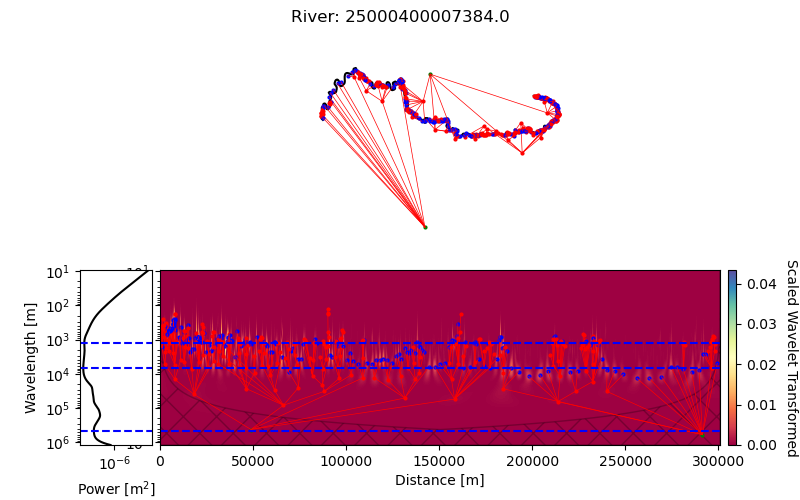

In [10]:
# Plot tree
rivers[id_river].plot_tree_nodes(markersize=2, linewidth=0.5)


In [9]:
# Save meanders in shapefile
path_project = f'{path_output}/meander_automatic_detection/'
rivers[id_river].save_meanders_database(
    path_output=path_project, file_name='meander_database.shp',
    database='meander', type_info='shapefile', geometry_columns=['x', 'y'],
    crs='esri:102003')

d:\work\myrepos\pymeanders\pyMeander\utilities\filesManagement.py:126: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  data.to_file(name_out)
d:\work\myrepos\pymeanders\pyMeander\utilities\filesManagement.py:126: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  data.to_file(name_out)


In [ ]:
# Plot Statistics of meanders
database = rivers[id_river].database

columns = database.columns.values